In [1]:
import os, glob
import json
import folium
import pandas as pd
import numpy as np
import polars as pl
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import mean_absolute_error
from math import sqrt
from statsmodels.tsa.seasonal import seasonal_decompose


import warnings
# Filter out specific ValueWarnings from statsmodels
warnings.filterwarnings("ignore")

# 1. Load data

In [2]:
root = r"C:\Users\lenovo\nhatquang\project\ads_enfit\data"

## Define important columns
data_cols = ['target', 'county', 'is_business', 'product_type', 'is_consumption', 'datetime', 'row_id','prediction_unit_id']
client_cols = ['product_type', 'county', 'eic_count', 'installed_capacity', 'is_business', 'date']
gas_prices_cols = ['forecast_date', 'lowest_price_per_mwh', 'highest_price_per_mwh','origin_date','data_block_id']
electricity_prices_cols = ['forecast_date', 'euros_per_mwh','origin_date','data_block_id']
forecast_weather_cols = ['latitude', 'longitude', 'hours_ahead', 'temperature', 'dewpoint', 'cloudcover_high', 'cloudcover_low', 'cloudcover_mid', 'cloudcover_total', '10_metre_u_wind_component', '10_metre_v_wind_component', 'forecast_datetime', 'direct_solar_radiation', 'surface_solar_radiation_downwards', 'snowfall', 'total_precipitation']
historical_weather_cols = ['datetime', 'temperature', 'dewpoint', 'rain', 'snowfall', 'surface_pressure','cloudcover_total','cloudcover_low','cloudcover_mid','cloudcover_high','windspeed_10m','winddirection_10m','shortwave_radiation','direct_solar_radiation','diffuse_radiation','latitude','longitude']
location_cols = ['longitude', 'latitude', 'county']
target_cols = ['target', 'county', 'is_business', 'product_type', 'is_consumption', 'datetime']

## Importing only specified columns
df_data = pl.read_csv(os.path.join(root, "train.csv"), columns=data_cols, try_parse_dates=True)
df_client = pl.read_csv(os.path.join(root, "client.csv"), columns=client_cols, try_parse_dates=True)
df_gas_prices = pl.read_csv(os.path.join(root, "gas_prices.csv"), columns=gas_prices_cols, try_parse_dates=True)
df_electricity_prices = pl.read_csv(os.path.join(root, "electricity_prices.csv"), columns=electricity_prices_cols, try_parse_dates=True)
df_forecast_weather = pl.read_csv(os.path.join(root, "forecast_weather.csv"), columns=forecast_weather_cols, try_parse_dates=True)
df_historical_weather = pl.read_csv(os.path.join(root, "historical_weather.csv"), columns=historical_weather_cols, try_parse_dates=True)
df_weather_station_to_county_mapping = pl.read_csv(os.path.join(root, "weather_station_to_county_mapping.csv"), columns=location_cols, try_parse_dates=True)
df_target = df_data.select(target_cols)


#### Use ERD to display data information for each table

#### Mô tả Bộ Dữ Liệu
Thử thách của bạn trong cuộc thi này là dự đoán lượng điện được sản xuất và tiêu thụ bởi các khách hàng năng lượng ở Estonia đã lắp đặt các tấm pin mặt trời. Bạn sẽ có quyền truy cập vào dữ liệu thời tiết, giá năng lượng liên quan và hồ sơ về công suất quang điện được lắp đặt.

Đây là cuộc thi dự báo sử dụng API chuỗi thời gian. Bảng xếp hạng riêng tư sẽ được xác định bằng dữ liệu thực tế thu thập sau khi kết thúc thời gian nộp bài.

💡 Lưu ý:
Tất cả các bộ dữ liệu tuân theo cùng một quy ước thời gian. Thời gian được cung cấp theo EET/EEST. Hầu hết các biến là tổng hoặc trung bình trong khoảng thời gian 1 giờ. Cột datetime (dù tên là gì) luôn cho biết thời điểm bắt đầu của khoảng thời gian 1 giờ. Tuy nhiên, đối với các bộ dữ liệu thời tiết, một số biến như nhiệt độ hoặc độ che phủ mây được cung cấp cho một thời điểm cụ thể, luôn là thời điểm kết thúc của khoảng thời gian 1 giờ.

Các tệp
train.csv

- county: Mã ID cho huyện.
- is_business: Boolean cho biết liệu người tiêu thụ có phải là doanh nghiệp hay không.
- product_type: Mã ID với ánh xạ sau đây của các mã tới các loại hợp đồng: {0: "Combined", 1: "Fixed", 2: "General service", 3: "Spot"}.
- target: Lượng tiêu thụ hoặc sản xuất cho phân đoạn liên quan trong giờ. Các phân đoạn được xác định bởi county, is_business, và product_type.
- is_consumption: Boolean cho biết liệu mục tiêu của hàng này là tiêu thụ hay sản xuất.
- datetime: Thời gian Estonia theo EET (UTC+2) / EEST (UTC+3). Nó mô tả thời điểm bắt đầu của khoảng thời gian 1 giờ mà mục tiêu được cung cấp.
- data_block_id: Tất cả các hàng chia sẻ cùng một data_block_id sẽ có sẵn tại cùng thời điểm dự báo. Đây là chức năng của những thông tin có sẵn khi các dự báo thực sự được thực hiện, vào lúc 11 giờ sáng mỗi ngày. Ví dụ, nếu dự báo thời tiết data_block_id cho các dự báo được thực hiện vào ngày 31 tháng 10 là 100 thì data_block_id thời tiết lịch sử cho ngày 31 tháng 10 sẽ là 101 vì dữ liệu thời tiết lịch sử chỉ thực sự có sẵn vào ngày hôm sau.
- row_id: Một mã định danh duy nhất cho hàng.
- prediction_unit_id: Một mã định danh duy nhất cho sự kết hợp giữa county, is_business, và product_type. Các đơn vị dự báo mới có thể xuất hiện hoặc biến mất trong tập kiểm tra.

gas_prices.csv

- origin_date: Ngày khi giá trước một ngày có sẵn.
- forecast_date: Ngày khi giá dự báo có liên quan.
- [lowest/highest]_price_per_mwh: Giá thấp nhất/cao nhất của khí đốt tự nhiên trên thị trường trước một ngày vào ngày giao dịch đó, tính bằng Euro mỗi megawatt giờ tương đương.
- data_block_id

client.csv

- product_type
- county: Mã ID cho huyện. Xem county_id_to_name_map.json để ánh xạ mã ID tới tên huyện.
- eic_count: Số điểm tiêu thụ tổng hợp (EICs - Mã định danh Châu Âu).
- installed_capacity: Công suất tấm pin mặt trời quang điện được lắp đặt tính bằng kilowatt.
- is_business: Boolean cho biết liệu người tiêu thụ có phải là doanh nghiệp hay không.
- date
- data_block_id

electricity_prices.csv

- origin_date
- forecast_date: Đại diện cho thời điểm bắt đầu của khoảng thời gian 1 giờ khi giá có hiệu lực.
- euros_per_mwh: Giá điện trên các thị trường trước một ngày tính bằng Euro mỗi megawatt giờ.
- data_block_id

forecast_weather.csv

Dự báo thời tiết có sẵn vào thời điểm dự báo. Nguồn từ Trung tâm Dự báo Thời tiết Tầm trung Châu Âu.

- [latitude/longitude]: Tọa độ của dự báo thời tiết.
- origin_datetime: Dấu thời gian của khi dự báo được tạo ra.
- hours_ahead: Số giờ giữa thời điểm tạo dự báo và thời điểm dự báo thời tiết. Mỗi dự báo bao gồm tổng cộng 48 giờ.
- temperature: Nhiệt độ không khí ở 2 mét trên mặt đất tính bằng độ C. Được ước tính cho thời điểm kết thúc của khoảng thời gian 1 giờ.
- dewpoint: Nhiệt độ điểm sương ở 2 mét trên mặt đất tính bằng độ C. Được ước tính cho thời điểm kết thúc của khoảng thời gian 1 giờ.
- cloudcover_[low/mid/high/total]: Tỷ lệ phần trăm của bầu trời được che phủ bởi mây ở các dải độ cao sau: 0-2 km, 2-6 km, 6+ km, và tổng cộng. Được ước tính cho thời điểm kết thúc của khoảng thời gian 1 giờ.
- 10_metre_[u/v]_wind_component: Thành phần [hướng đông/hướng bắc] của tốc độ gió đo ở 10 mét trên bề mặt tính bằng mét trên giây. Được ước tính cho thời điểm kết thúc của khoảng thời gian 1 giờ.
- data_block_id
- forecast_datetime: Dấu thời gian của thời tiết dự báo. Được tạo từ origin_datetime cộng với hours_ahead. Điều này đại diện cho thời điểm bắt đầu của khoảng thời gian 1 giờ mà dữ liệu thời tiết được dự báo.
- direct_solar_radiation: Bức xạ mặt trời trực tiếp chiếu xuống bề mặt trên một mặt phẳng vuông góc với hướng của mặt trời tích lũy trong giờ, tính bằng watt-giờ trên mét vuông.
- surface_solar_radiation_downwards: Bức xạ mặt trời, bao gồm cả trực tiếp và khuếch tán, chiếu xuống một mặt phẳng ngang trên bề mặt Trái Đất, tích lũy trong giờ, tính bằng watt-giờ trên mét vuông.
- snowfall: Lượng tuyết rơi trong giờ tính bằng mét nước tương đương.
- total_precipitation: Lượng mưa tích lũy, bao gồm cả mưa và tuyết rơi trên bề mặt Trái Đất trong giờ được mô tả, tính bằng mét.

historical_weather.csv

Dữ liệu thời tiết lịch sử.

- datetime: Đại diện cho thời điểm bắt đầu của khoảng thời gian 1 giờ mà dữ liệu thời tiết được đo.
- temperature: Được đo ở thời điểm kết thúc của khoảng thời gian 1 giờ.
- dewpoint: Được đo ở thời điểm kết thúc của khoảng thời gian 1 giờ.
- rain: Khác với các quy ước dự báo. Lượng mưa từ các hệ thống thời tiết lớn trong giờ tính bằng milimet.
- snowfall: Khác với các quy ước dự báo. Lượng tuyết rơi trong giờ tính bằng centimet.
- surface_pressure: Áp suất không khí ở mặt đất tính bằng hectopascal.
- cloudcover_[low/mid/high/total]: Khác với các quy ước dự báo. Độ che phủ mây ở các độ cao 0-3 km, 3-8 km, 8+, và tổng cộng.
- windspeed_10m: Khác với các quy ước dự báo. Tốc độ gió ở 10 mét trên mặt đất tính bằng mét trên giây.
- winddirection_10m: Khác với các quy ước dự báo. Hướng gió ở 10 mét trên mặt đất tính bằng độ.
- shortwave_radiation: Khác với các quy ước dự báo. Bức xạ toàn cầu trên mặt phẳng ngang tính bằng watt-giờ trên mét vuông.
- direct_solar_radiation
- diffuse_radiation: Khác với các quy ước dự báo. Bức xạ khuếch tán tính bằng watt-giờ trên mét vuông.
- [latitude/longitude]: Tọa độ của trạm thời tiết.
- data_block_id

public_timeseries_testing_util.py

Một tệp tùy chọn nhằm giúp dễ dàng hơn khi chạy các bài kiểm tra API tùy chỉnh offline. Xem docstring của script để biết chi tiết. Bạn sẽ cần chỉnh sửa tệp này trước khi sử dụng.

example_test_files/

Dữ liệu nhằm minh họa cách API hoạt động. Bao gồm các tệp và cột tương tự được cung cấp bởi API. Ba data_block_id đầu tiên là sự lặp lại của ba data_block_id cuối cùng trong tập huấn luyện.

example_test_files/sample_submission.csv

Một mẫu nộp hợp lệ, được cung cấp bởi API. Xem notebook này để biết một ví dụ rất đơn giản về cách sử dụng mẫu nộp.

example_test_files/revealed_targets.csv

Các giá trị mục tiêu thực tế từ ngày trước thời gian dự báo. Điều này tương đương với độ trễ hai ngày so với thời gian dự báo trong test.csv.

enefit/

Các tệp cho phép API hoạt động. Dự kiến API sẽ cung cấp tất cả các hàng trong vòng dưới 15 phút và chỉ sử dụng ít hơn 0,5

 GB bộ nhớ. Phiên bản API mà bạn có thể tải xuống cung cấp dữ liệu từ example_test_files/. Bạn phải đưa ra dự báo cho những ngày đó để tiến hành API nhưng những dự báo đó sẽ không được chấm điểm. Dự kiến có khoảng ba tháng dữ liệu được cung cấp ban đầu và tối đa mười tháng dữ liệu vào cuối kỳ dự báo.

In [3]:
# from IPython.display import Image
# import graphviz
# import os

# # Create Digraph object
# dot = graphviz.Digraph(comment='My Graph')

# # Define tables and columns along with primary and foreign keys
# tables = {
#     'df_target': {
#         'columns': df_target.columns,
#         'primary_key': 'datetime',
#         'foreign_keys': {}  # Add foreign_keys if any
#     },
#     'df_gas_prices': {
#         'columns': df_gas_prices.columns,
#         'primary_key': 'forecast_date ',
#         'foreign_keys': {}  # Add foreign_keys if any
#     },
#     'df_electricity_prices': {
#         'columns': df_electricity_prices.columns,
#         'primary_key': 'forecast_date ',
#         'foreign_keys': {}  # Add foreign_keys if any
#     },
#     'df_forecast_weather': {
#         'columns': df_forecast_weather.columns,
#         'primary_key': 'datetime',
#         'foreign_keys': {}  # Add foreign_keys if any
#     },
#     'df_historical_weather': {
#         'columns': df_historical_weather.columns,
#         'primary_key': 'datetime',
#         'foreign_keys': {}  # Add foreign_keys if any
#     },
#     'df_weather_station_to_county_mapping': {
#         'columns': df_weather_station_to_county_mapping.columns,
#         'primary_key': 'county',  # Assuming station_id is the primary key
#         'foreign_keys': {}  # Add foreign_keys if any
#     },
#     'df_client': {
#         'columns': df_client.columns,
#         'primary_key': 'date',  # Assuming client_id is the primary key
#         'foreign_keys': {}  # Add foreign_keys if any
#     }
# }

# # Add tables to the graph
# for table, details in tables.items():
#     columns = details['columns']
#     primary_key = details['primary_key']
#     foreign_keys = details['foreign_keys']
    
#     # Create labels for columns
#     column_labels = []
#     for column in columns:
#         if column == primary_key:
#             column_labels.append(f'<{column}> {column} (PK)')
#         elif column in foreign_keys:
#             column_labels.append(f'<{column}> {column} (FK)')
#         else:
#             column_labels.append(f'<{column}> {column}')
    
#     # Add table to the graph
#     label = f'{{{table} | {"|".join(column_labels)}}}'
#     dot.node(table, label=label, shape='record')

# # Add foreign key relationships to the graph
# for table, details in tables.items():
#     foreign_keys = details['foreign_keys']
#     for fk, ref_table in foreign_keys.items():
#         dot.edge(f'{table}:{fk}', f'{ref_table}:{fk}')

# # Render and save the graph as a PNG file
# output_path = 'ERD'
# dot.render(output_path, format='png')

# # Display the image
# display_image_path = output_path + '.png'
# if os.path.exists(display_image_path):
#     display(Image(display_image_path))
# else:
#     print("Error: The image file was not created.")


### a. Descriptive Statistic

In [4]:
print(f"Data size: {len(df_data )}")

display(df_data.head())

Data size: 2018352


county,is_business,product_type,target,is_consumption,datetime,row_id,prediction_unit_id
i64,i64,i64,f64,i64,datetime[μs],i64,i64
0,0,1,0.713,0,2021-09-01 00:00:00,0,0
0,0,1,96.59,1,2021-09-01 00:00:00,1,0
0,0,2,0.0,0,2021-09-01 00:00:00,2,1
0,0,2,17.314,1,2021-09-01 00:00:00,3,1
0,0,3,2.904,0,2021-09-01 00:00:00,4,2


In [5]:
df_data.to_pandas().info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2018352 entries, 0 to 2018351
Data columns (total 8 columns):
 #   Column              Dtype         
---  ------              -----         
 0   county              int64         
 1   is_business         int64         
 2   product_type        int64         
 3   target              float64       
 4   is_consumption      int64         
 5   datetime            datetime64[us]
 6   row_id              int64         
 7   prediction_unit_id  int64         
dtypes: datetime64[us](1), float64(1), int64(6)
memory usage: 123.2 MB


In [6]:
print(f"Gas size: {len(df_gas_prices )}")

display(df_gas_prices.head())

Gas size: 637


forecast_date,lowest_price_per_mwh,highest_price_per_mwh,origin_date,data_block_id
date,f64,f64,date,i64
2021-09-01,45.23,46.32,2021-08-31,1
2021-09-02,45.62,46.29,2021-09-01,2
2021-09-03,45.85,46.4,2021-09-02,3
2021-09-04,46.3,46.8,2021-09-03,4
2021-09-05,46.3,46.58,2021-09-04,5


In [7]:
df_gas_prices.to_pandas().info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 637 entries, 0 to 636
Data columns (total 5 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   forecast_date          637 non-null    datetime64[ms]
 1   lowest_price_per_mwh   637 non-null    float64       
 2   highest_price_per_mwh  637 non-null    float64       
 3   origin_date            637 non-null    datetime64[ms]
 4   data_block_id          637 non-null    int64         
dtypes: datetime64[ms](2), float64(2), int64(1)
memory usage: 25.0 KB


In [8]:

print(f"Electric size: {len(df_electricity_prices )}")

display(df_electricity_prices.head())

Electric size: 15286


forecast_date,euros_per_mwh,origin_date,data_block_id
datetime[μs],f64,datetime[μs],i64
2021-09-01 00:00:00,92.51,2021-08-31 00:00:00,1
2021-09-01 01:00:00,88.9,2021-08-31 01:00:00,1
2021-09-01 02:00:00,87.35,2021-08-31 02:00:00,1
2021-09-01 03:00:00,86.88,2021-08-31 03:00:00,1
2021-09-01 04:00:00,88.43,2021-08-31 04:00:00,1


In [9]:
df_electricity_prices.to_pandas().info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15286 entries, 0 to 15285
Data columns (total 4 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   forecast_date  15286 non-null  datetime64[us]
 1   euros_per_mwh  15286 non-null  float64       
 2   origin_date    15286 non-null  datetime64[us]
 3   data_block_id  15286 non-null  int64         
dtypes: datetime64[us](2), float64(1), int64(1)
memory usage: 477.8 KB


In [10]:
print(f"Client size: {len(df_client )}")

display(df_client.head())

Client size: 41919


product_type,county,eic_count,installed_capacity,is_business,date
i64,i64,i64,f64,i64,date
1,0,108,952.89,0,2021-09-01
2,0,17,166.4,0,2021-09-01
3,0,688,7207.88,0,2021-09-01
0,0,5,400.0,1,2021-09-01
1,0,43,1411.0,1,2021-09-01


In [11]:
df_client.to_pandas().info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41919 entries, 0 to 41918
Data columns (total 6 columns):
 #   Column              Non-Null Count  Dtype         
---  ------              --------------  -----         
 0   product_type        41919 non-null  int64         
 1   county              41919 non-null  int64         
 2   eic_count           41919 non-null  int64         
 3   installed_capacity  41919 non-null  float64       
 4   is_business         41919 non-null  int64         
 5   date                41919 non-null  datetime64[ms]
dtypes: datetime64[ms](1), float64(1), int64(4)
memory usage: 1.9 MB


In [12]:
print(f"forecast size: {len(df_forecast_weather )}")

display(df_forecast_weather.head())

forecast size: 3424512


latitude,longitude,hours_ahead,temperature,dewpoint,cloudcover_high,cloudcover_low,cloudcover_mid,cloudcover_total,10_metre_u_wind_component,10_metre_v_wind_component,forecast_datetime,direct_solar_radiation,surface_solar_radiation_downwards,snowfall,total_precipitation
f64,f64,i64,f64,f64,f64,f64,f64,f64,f64,f64,datetime[μs],f64,f64,f64,f64
57.6,21.7,1,15.655786,11.553613,0.904816,0.019714,0.0,0.905899,-0.411328,-9.106137,2021-09-01 03:00:00,0.0,0.0,0.0,0.0
57.6,22.2,1,13.003931,10.689844,0.886322,0.004456,0.0,0.886658,0.206347,-5.355405,2021-09-01 03:00:00,0.0,0.0,0.0,0.0
57.6,22.7,1,14.206567,11.671777,0.729034,0.005615,0.0,0.730499,1.451587,-7.417905,2021-09-01 03:00:00,0.0,0.0,0.0,0.0
57.6,23.2,1,14.844507,12.264917,0.336304,0.074341,0.000626,0.385468,1.090869,-9.163999,2021-09-01 03:00:00,0.0,0.0,0.0,0.0
57.6,23.7,1,15.293848,12.458887,0.102875,0.088074,0.000015,0.17659,1.268481,-8.975766,2021-09-01 03:00:00,0.0,0.0,0.0,0.0


In [13]:
df_forecast_weather.to_pandas().info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3424512 entries, 0 to 3424511
Data columns (total 16 columns):
 #   Column                             Dtype         
---  ------                             -----         
 0   latitude                           float64       
 1   longitude                          float64       
 2   hours_ahead                        int64         
 3   temperature                        float64       
 4   dewpoint                           float64       
 5   cloudcover_high                    float64       
 6   cloudcover_low                     float64       
 7   cloudcover_mid                     float64       
 8   cloudcover_total                   float64       
 9   10_metre_u_wind_component          float64       
 10  10_metre_v_wind_component          float64       
 11  forecast_datetime                  datetime64[us]
 12  direct_solar_radiation             float64       
 13  surface_solar_radiation_downwards  float64       
 14  sn

In [14]:
np.unique(df_forecast_weather.to_pandas().hours_ahead)

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34,
       35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48],
      dtype=int64)

In [15]:
print(f"histirical size: {len(df_historical_weather )}")

display(df_historical_weather.head())

histirical size: 1710802


datetime,temperature,dewpoint,rain,snowfall,surface_pressure,cloudcover_total,cloudcover_low,cloudcover_mid,cloudcover_high,windspeed_10m,winddirection_10m,shortwave_radiation,direct_solar_radiation,diffuse_radiation,latitude,longitude
datetime[μs],f64,f64,f64,f64,f64,i64,i64,i64,i64,f64,i64,f64,f64,f64,f64,f64
2021-09-01 00:00:00,14.2,11.6,0.0,0.0,1015.9,31,31,0,11,7.083333,8,0.0,0.0,0.0,57.6,21.7
2021-09-01 00:00:00,13.9,11.5,0.0,0.0,1010.7,33,37,0,0,5.111111,359,0.0,0.0,0.0,57.6,22.2
2021-09-01 00:00:00,14.0,12.5,0.0,0.0,1015.0,31,34,0,0,6.333333,355,0.0,0.0,0.0,57.6,22.7
2021-09-01 00:00:00,14.6,11.5,0.0,0.0,1017.3,0,0,0,0,8.083333,297,358.0,277.0,81.0,57.6,23.2
2021-09-01 00:00:00,15.7,12.9,0.0,0.0,1014.0,22,25,0,0,8.416667,5,0.0,0.0,0.0,57.6,23.7


In [16]:
df_historical_weather.to_pandas().info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1710802 entries, 0 to 1710801
Data columns (total 17 columns):
 #   Column                  Dtype         
---  ------                  -----         
 0   datetime                datetime64[us]
 1   temperature             float64       
 2   dewpoint                float64       
 3   rain                    float64       
 4   snowfall                float64       
 5   surface_pressure        float64       
 6   cloudcover_total        int64         
 7   cloudcover_low          int64         
 8   cloudcover_mid          int64         
 9   cloudcover_high         int64         
 10  windspeed_10m           float64       
 11  winddirection_10m       int64         
 12  shortwave_radiation     float64       
 13  direct_solar_radiation  float64       
 14  diffuse_radiation       float64       
 15  latitude                float64       
 16  longitude               float64       
dtypes: datetime64[us](1), float64(11), int64(5)
me

In [17]:
print(f"Weather station size: {len(df_weather_station_to_county_mapping )}")
print(type(df_weather_station_to_county_mapping))

df_weather_station_to_county_mapping = df_weather_station_to_county_mapping.drop_nulls()
display(df_weather_station_to_county_mapping)

Weather station size: 112
<class 'polars.dataframe.frame.DataFrame'>


longitude,latitude,county
f64,f64,i64
22.2,58.2,10
22.2,58.5,10
22.7,58.5,10
22.7,58.8,1
23.2,58.5,10
…,…,…
27.2,59.1,2
27.2,59.4,2
27.7,57.9,15


In [18]:
print(f"Weather station size: {len(df_weather_station_to_county_mapping )}")

display(df_weather_station_to_county_mapping.head())

Weather station size: 49


longitude,latitude,county
f64,f64,i64
22.2,58.2,10
22.2,58.5,10
22.7,58.5,10
22.7,58.8,1
23.2,58.5,10


In [19]:
df_weather_station_to_county_mapping.to_pandas().info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49 entries, 0 to 48
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   longitude  49 non-null     float64
 1   latitude   49 non-null     float64
 2   county     49 non-null     int64  
dtypes: float64(2), int64(1)
memory usage: 1.3 KB


In [20]:
print(f"Weather station size: {len(df_target )}")

display(df_target.head())

Weather station size: 2018352


target,county,is_business,product_type,is_consumption,datetime
f64,i64,i64,i64,i64,datetime[μs]
0.713,0,0,1,0,2021-09-01 00:00:00
96.59,0,0,1,1,2021-09-01 00:00:00
0.0,0,0,2,0,2021-09-01 00:00:00
17.314,0,0,2,1,2021-09-01 00:00:00
2.904,0,0,3,0,2021-09-01 00:00:00


In [21]:
df_target.to_pandas().info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2018352 entries, 0 to 2018351
Data columns (total 6 columns):
 #   Column          Dtype         
---  ------          -----         
 0   target          float64       
 1   county          int64         
 2   is_business     int64         
 3   product_type    int64         
 4   is_consumption  int64         
 5   datetime        datetime64[us]
dtypes: datetime64[us](1), float64(1), int64(4)
memory usage: 92.4 MB


In [22]:
print(f"Data is followed from '{min(df_target['datetime'])}' to '{max(df_target['datetime'])}'")

Data is followed from '2021-09-01 00:00:00' to '2023-05-31 23:00:00'


In [23]:
with open(os. path.join(root, f"county_id_to_name_map.json")) as fo:
    county_id_to_name = json.load(fo)
print(county_id_to_name)

{'0': 'HARJUMAA', '1': 'HIIUMAA', '2': 'IDA-VIRUMAA', '3': 'JÄRVAMAA', '4': 'JÕGEVAMAA', '5': 'LÄÄNE-VIRUMAA', '6': 'LÄÄNEMAA', '7': 'PÄRNUMAA', '8': 'PÕLVAMAA', '9': 'RAPLAMAA', '10': 'SAAREMAA', '11': 'TARTUMAA', '12': 'UNKNOWN', '13': 'VALGAMAA', '14': 'VILJANDIMAA', '15': 'VÕRUMAA'}


In [24]:
counties_locations = {
    "HARJUMAA": (59.351142, 24.725384),
    "HIIUMAA": (58.918082, 22.586403),
    "IDA-VIRUMAA": (59.228971, 27.406654),
    "JÄRVAMAA": (58.897934, 25.623048),
    "JÕGEVAMAA": (58.727941, 26.413961),
    "LÄÄNE-VIRUMAA": (59.267897, 26.363968),
    "LÄÄNEMAA": (58.975935, 23.772451),
    "PÄRNUMAA": (58.448793, 24.526469),
    "PÕLVAMAA": (58.089925, 27.101149),
    "RAPLAMAA": (58.924451, 24.619842),
    "SAAREMAA": (58.414075, 22.525137),
    "TARTUMAA": (58.394168, 26.747568),
    "VALGAMAA": (57.933466, 26.191360),
    "VILJANDIMAA": (58.316916, 25.595130),
    "VÕRUMAA": (57.765485, 27.025669)
}

In [25]:
cols_loc = ["latitude", "longitude"]
weather_locations = df_historical_weather.to_pandas().groupby(cols_loc).size().reset_index()[cols_loc]
display(weather_locations)

,latitude,longitude
0,57.6,21.7
1,57.6,22.2
2,57.6,22.7
3,57.6,23.2
4,57.6,23.7
...,...,...
107,59.7,26.2
108,59.7,26.7
109,59.7,27.2
110,59.7,27.7


# 2. Transform and pre-processing 

In [26]:
def generate_features(df_data, df_client, df_gas_prices, df_electricity_prices, df_forecast_weather, df_historical_weather, df_weather_station_to_county_mapping, df_target):
    df_data = (
        df_data.with_columns(pl.col("datetime").cast(pl.Date).alias("date"),)
    )
    
    df_gas_prices = (
        df_gas_prices.rename({"forecast_date": "date"})
    )
    
    df_electricity_prices = (
        df_electricity_prices.rename({"forecast_date": "datetime"})
    )
    
    df_weather_station_to_county_mapping = (
        df_weather_station_to_county_mapping.with_columns(pl.col("latitude").cast(pl.datatypes.Float32),pl.col("longitude").cast(pl.datatypes.Float32))
    )
    
    # sum of all product_type targets related to ["datetime", "county", "is_business", "is_consumption"]
    df_target_all_type_sum = (
        df_target.group_by(["datetime", "county", "is_business", "is_consumption"]).sum().drop("product_type")
    )
    
    df_forecast_weather = (
        df_forecast_weather.rename({"forecast_datetime": "datetime"}).filter(pl.col("hours_ahead") >= 24) # we don't need forecast for today
        .with_columns(pl.col("latitude").cast(pl.datatypes.Float32),pl.col("longitude").cast(pl.datatypes.Float32),
            # datetime for forecast in a different timezone
            pl.col('datetime').dt.replace_time_zone(None).cast(pl.Datetime("us")),
        )
        .join(df_weather_station_to_county_mapping, how="left", on=["longitude", "latitude"]).drop("longitude", "latitude")
    )
    
    df_historical_weather = (
        df_historical_weather
        .with_columns(pl.col("latitude").cast(pl.datatypes.Float32),pl.col("longitude").cast(pl.datatypes.Float32),
        )
        .join(df_weather_station_to_county_mapping, how="left", on=["longitude", "latitude"]).drop("longitude", "latitude")
    )
    
    # creating average forecast characteristics for all weather stations
    df_forecast_weather_date = (
        df_forecast_weather.group_by("datetime").mean().drop("county")
    )
    
    # creating average forecast characteristics for weather stations related to county
    df_forecast_weather_local = (
        df_forecast_weather.filter(pl.col("county").is_not_null()).group_by("county", "datetime").mean()
    )
    
    # creating average historical characteristics for all weather stations
    df_historical_weather_date = (
        df_historical_weather.group_by("datetime").mean().drop("county")
    )
    
    # creating average historical characteristics for weather stations related to county
    df_historical_weather_local = (
        df_historical_weather.filter(pl.col("county").is_not_null()).group_by("county", "datetime").mean()
    )
    
    df_data = (
        df_data
        # pl.duration(days=1) shifts datetime to join lag features (usually we join last available values)
        .join(df_gas_prices.with_columns((pl.col("date") + pl.duration(days=1)).cast(pl.Date)), on="date", how="left")
        .join(df_client.with_columns((pl.col("date") + pl.duration(days=2)).cast(pl.Date)), on=["county", "is_business", "product_type", "date"], how="left")
        .join(df_electricity_prices.with_columns(pl.col("datetime") + pl.duration(days=1)), on="datetime", how="left")
        
        # lag forecast_weather features (24 hours * days)
        .join(df_forecast_weather_date, on="datetime", how="left", suffix="_fd")
        .join(df_forecast_weather_local, on=["county", "datetime"], how="left", suffix="_fl")
        .join(df_forecast_weather_date.with_columns(pl.col("datetime") + pl.duration(days=7)), on="datetime", how="left", suffix="_fd_7d")
        .join(df_forecast_weather_local.with_columns(pl.col("datetime") + pl.duration(days=7)), on=["county", "datetime"], how="left", suffix="_fl_7d")

        # lag historical_weather features (24 hours * days)
        .join(df_historical_weather_date.with_columns(pl.col("datetime") + pl.duration(days=2)), on="datetime", how="left", suffix="_hd_2d")
        .join(df_historical_weather_local.with_columns(pl.col("datetime") + pl.duration(days=2)), on=["county", "datetime"], how="left", suffix="_hl_2d")
        .join(df_historical_weather_date.with_columns(pl.col("datetime") + pl.duration(days=7)), on="datetime", how="left", suffix="_hd_7d")
        .join(df_historical_weather_local.with_columns(pl.col("datetime") + pl.duration(days=7)), on=["county", "datetime"], how="left", suffix="_hl_7d")
        
        # lag target features (24 hours * days)
        .join(df_target.with_columns(pl.col("datetime") + pl.duration(days=2)).rename({"target": "target_1"}), on=["county", "is_business", "product_type", "is_consumption", "datetime"], how="left")
        .join(df_target.with_columns(pl.col("datetime") + pl.duration(days=3)).rename({"target": "target_2"}), on=["county", "is_business", "product_type", "is_consumption", "datetime"], how="left")
        .join(df_target.with_columns(pl.col("datetime") + pl.duration(days=4)).rename({"target": "target_3"}), on=["county", "is_business", "product_type", "is_consumption", "datetime"], how="left")
        .join(df_target.with_columns(pl.col("datetime") + pl.duration(days=5)).rename({"target": "target_4"}), on=["county", "is_business", "product_type", "is_consumption", "datetime"], how="left")
        .join(df_target.with_columns(pl.col("datetime") + pl.duration(days=6)).rename({"target": "target_5"}), on=["county", "is_business", "product_type", "is_consumption", "datetime"], how="left")
        .join(df_target.with_columns(pl.col("datetime") + pl.duration(days=7)).rename({"target": "target_6"}), on=["county", "is_business", "product_type", "is_consumption", "datetime"], how="left")
        .join(df_target.with_columns(pl.col("datetime") + pl.duration(days=14)).rename({"target": "target_7"}), on=["county", "is_business", "product_type", "is_consumption", "datetime"], how="left")
        
        .join(df_target_all_type_sum.with_columns(pl.col("datetime") + pl.duration(days=2)).rename({"target": "target_1"}), on=["county", "is_business", "is_consumption", "datetime"], suffix="_all_type_sum", how="left")
        .join(df_target_all_type_sum.with_columns(pl.col("datetime") + pl.duration(days=3)).rename({"target": "target_2"}), on=["county", "is_business", "is_consumption", "datetime"], suffix="_all_type_sum", how="left")
        .join(df_target_all_type_sum.with_columns(pl.col("datetime") + pl.duration(days=7)).rename({"target": "target_6"}), on=["county", "is_business", "is_consumption", "datetime"], suffix="_all_type_sum", how="left")
        .join(df_target_all_type_sum.with_columns(pl.col("datetime") + pl.duration(days=14)).rename({"target": "target_7"}), on=["county", "is_business", "is_consumption", "datetime"], suffix="_all_type_sum", how="left")
        
        
        .with_columns(
            pl.col("datetime").dt.ordinal_day().alias("dayofyear"),
            pl.col("datetime").dt.hour().alias("hour"),
            pl.col("datetime").dt.day().alias("day"),
            pl.col("datetime").dt.weekday().alias("weekday"),
            pl.col("datetime").dt.month().alias("month"),
            pl.col("datetime").dt.year().alias("year"),
        )
        .with_columns(
            pl.concat_str("county", "is_business", "product_type", "is_consumption", separator="_").alias("segment"),
        )
        # cyclical features encoding https://towardsdatascience.com/cyclical-features-encoding-its-about-time-ce23581845ca
        .with_columns(
            (np.pi * pl.col("dayofyear") / 183).sin().alias("sin(dayofyear)"),
            (np.pi * pl.col("dayofyear") / 183).cos().alias("cos(dayofyear)"),
            (np.pi * pl.col("hour") / 12).sin().alias("sin(hour)"),
            (np.pi * pl.col("hour") / 12).cos().alias("cos(hour)"),
        )
        .with_columns(
            pl.col(pl.Float64).cast(pl.Float32),
        )
        
        .drop("datetime", "hour", "dayofyear")
    )
    
    return df_data

In [27]:
## Function defined for merging dataframes with the row_id as unique identifier
def to_pandas(X, y=None):
    cat_cols = ["county", "is_business", "product_type", "is_consumption", "segment"]
    
    if y is not None:
        df = pd.concat([X.to_pandas(), y.to_pandas()], axis=1)
    else:
        df = X.to_pandas()    
    
    df = df.set_index("row_id")
    df[cat_cols] = df[cat_cols].astype("category")
    
    df["target_mean"] = df[[f"target_{i}" for i in range(1, 7)]].mean(1)
    df["target_std"] = df[[f"target_{i}" for i in range(1, 7)]].std(1)
    df["target_ratio"] = df["target_6"] / (df["target_7"] + 1e-3)
    
    return df

## Applying Preprocessing

1. **Splitting Data into Features and Target**
   - `df_data` is updated to exclude the 'target' column.
   - `y` is created to contain only the 'target' column from `df_data`.

2. **Generating Additional Features**
   - The `generate_features` function is used to enrich `df_data` with new features created from related datasets like client, gas prices, electricity prices, forecast and historical weather data, and weather station mappings.

3. **Transforming Data for Pandas DataFrame**
   - The `to_pandas` function is applied to transform the enriched data into a pandas DataFrame, integrating the target values and creating additional engineered features such as 'target_mean', 'target_std', and 'target_ratio'.

4. **Cleaning Data**
   - Rows with null values in the 'target' column are removed to ensure data quality.
   - The dataset is filtered to include only records from the year 2022 and beyond.

The processed dataset, `df_train_features`, is now optimized and ready for use in machine learning tasks, free from null target values and focused on recent data.


In [28]:
df_data, y = df_data.drop("target"), df_data.select("target")

county_id_to_name = {
    0: 'HARJUMAA', 1: 'HIIUMAA', 2: 'IDA-VIRUMAA', 3: 'JÄRVAMAA', 4: 'JÕGEVAMAA', 
    5: 'LÄÄNE-VIRUMAA', 6: 'LÄNEMAA', 7: 'PÄRNUMAA', 8: 'PÕLVAMAA', 9: 'RAPLAMAA', 
    10: 'SAAREMAA', 11: 'TARTUMAA', 12: 'UNKNOWN', 13: 'VALGAMAA', 14: 'VILJANDIMAA', 15: 'VÕRUMAA'
}

# Chuyển cột 'county' thành kiểu chuỗi
# df_train_features['county'] = df_train_features['county'].astype(str)

# Tạo cột mới 'county_name' và ánh xạ giá trị của cột 'county' tới tên quận tương ứng

df_train_features = generate_features(df_data, df_client, df_gas_prices, df_electricity_prices, df_forecast_weather, df_historical_weather, df_weather_station_to_county_mapping, df_target)

df_train_features = to_pandas(df_train_features, y)
# a little proportion of target values are null
df_train_features = df_train_features[df_train_features['target'].notnull()]
# df_train_features['country'] = df_train_features['county'].map(county_id_to_name)


# filter old data
# df_train_features = df_train_features[df_train_features.year >= 2022]

df_train_features.head()

,county,is_business,product_type,is_consumption,prediction_unit_id,date,lowest_price_per_mwh,highest_price_per_mwh,origin_date,data_block_id,...,year,segment,sin(dayofyear),cos(dayofyear),sin(hour),cos(hour),target,target_mean,target_std,target_ratio
row_id,,,,,,,,,,,,,,,,,,,,,
0,0,0,1,0,0,2021-09-01,NaN,NaN,NaT,NaN,...,2021,0_0_1_0,-0.866025,-0.5,0.0,1.0,0.713,NaN,NaN,NaN
1,0,0,1,1,0,2021-09-01,NaN,NaN,NaT,NaN,...,2021,0_0_1_1,-0.866025,-0.5,0.0,1.0,96.590,NaN,NaN,NaN
2,0,0,2,0,1,2021-09-01,NaN,NaN,NaT,NaN,...,2021,0_0_2_0,-0.866025,-0.5,0.0,1.0,0.000,NaN,NaN,NaN
3,0,0,2,1,1,2021-09-01,NaN,NaN,NaT,NaN,...,2021,0_0_2_1,-0.866025,-0.5,0.0,1.0,17.314,NaN,NaN,NaN
4,0,0,3,0,2,2021-09-01,NaN,NaN,NaT,NaN,...,2021,0_0_3_0,-0.866025,-0.5,0.0,1.0,2.904,NaN,NaN,NaN


In [29]:
np.unique(df_train_features.segment)

array(['0_0_1_0', '0_0_1_1', '0_0_2_0', '0_0_2_1', '0_0_3_0', '0_0_3_1',
       '0_1_0_0', '0_1_0_1', '0_1_1_0', '0_1_1_1', '0_1_2_0', '0_1_2_1',
       '0_1_3_0', '0_1_3_1', '10_0_1_0', '10_0_1_1', '10_0_3_0',
       '10_0_3_1', '10_1_1_0', '10_1_1_1', '10_1_2_0', '10_1_2_1',
       '10_1_3_0', '10_1_3_1', '11_0_1_0', '11_0_1_1', '11_0_2_0',
       '11_0_2_1', '11_0_3_0', '11_0_3_1', '11_1_0_0', '11_1_0_1',
       '11_1_1_0', '11_1_1_1', '11_1_2_0', '11_1_2_1', '11_1_3_0',
       '11_1_3_1', '12_1_3_0', '12_1_3_1', '13_0_1_0', '13_0_1_1',
       '13_0_3_0', '13_0_3_1', '13_1_1_0', '13_1_1_1', '13_1_3_0',
       '13_1_3_1', '14_0_1_0', '14_0_1_1', '14_0_3_0', '14_0_3_1',
       '14_1_1_0', '14_1_1_1', '14_1_2_0', '14_1_2_1', '14_1_3_0',
       '14_1_3_1', '15_0_1_0', '15_0_1_1', '15_0_3_0', '15_0_3_1',
       '15_1_0_0', '15_1_0_1', '15_1_1_0', '15_1_1_1', '15_1_3_0',
       '15_1_3_1', '1_0_1_0', '1_0_1_1', '1_0_3_0', '1_0_3_1', '1_1_3_0',
       '1_1_3_1', '2_0_1_0', '2_0_1_1', '2_0_

# 3. EDA and Visualization

In [30]:
map_ = folium.Map(location=[58.595272, 25.013607], zoom_start=7)

for county, coords in counties_locations.items():
    folium.CircleMarker(
        location=[coords[0], coords[1]], radius=5, color='cornflowerblue', fill=True
    ).add_child(folium.Popup(county)).add_to(map_)

for _, loc in weather_locations.iterrows():
    folium.CircleMarker(
        location=[loc["latitude"], loc["longitude"]], radius=1, color='orange'
    ).add_to(map_)
    
map_

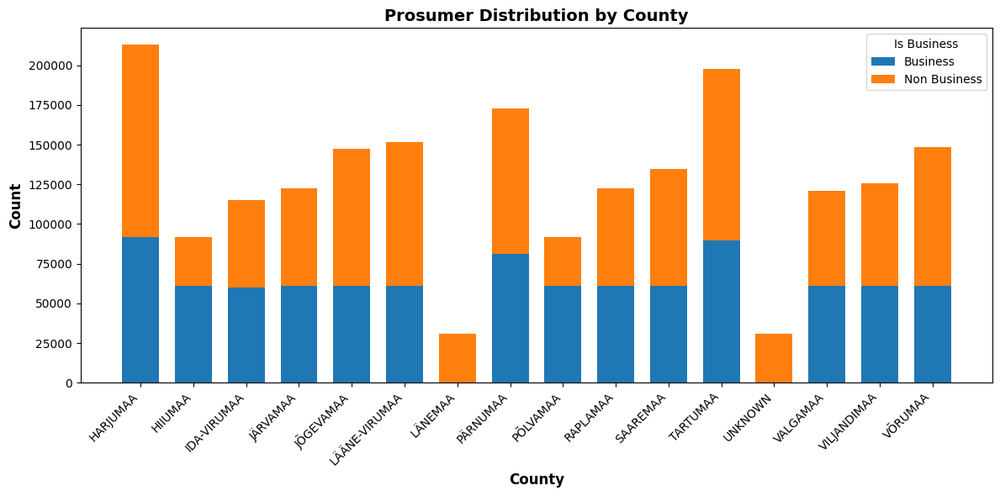

In [31]:
import matplotlib.pyplot as plt

# Chuẩn bị dữ liệu
non_business_counts = df_train_features[df_train_features['is_business'] == 1].groupby('county').size()
business_counts = df_train_features[df_train_features['is_business'] == 0].groupby('county').size()

# Tạo biểu đồ cột chồng
fig, ax = plt.subplots(figsize=(12, 6))

bar_width = 0.7

# Vẽ cột 'business' chồng lên 'non_business'
bar1 = ax.bar(range(len(business_counts)), business_counts, bar_width, label='Business')

# Vẽ cột 'non_business'
bar2 = ax.bar(range(len(non_business_counts)), non_business_counts, bar_width,bottom=business_counts.values, label='Non Business')



# Đặt nhãn và tiêu đề
ax.set_xlabel('County', fontsize=12, fontweight='bold')
ax.set_ylabel('Count', fontsize=12, fontweight='bold')
ax.set_title('Prosumer Distribution by County', fontsize=14, fontweight='bold')

# Thiết lập nhãn x nghiêng 45 độ
ax.set_xticks(range(len(non_business_counts)))
ax.set_xticklabels(non_business_counts.index.map(county_id_to_name.get), rotation=45, ha='right', fontsize=10)

# Thêm chú thích
ax.legend(title='Is Business', loc='upper right')

# Hiển thị biểu đồ
plt.tight_layout()
plt.show()


In [32]:
county_dict = df_train_features["county"].value_counts().to_dict()
county_df = pd.DataFrame({"County":county_dict.keys(), "Count":county_dict.values()})
# print(county_df)
px.bar(county_df, x="County", y="Count", title="County Distribution", color="County")
# ax.set_xticklabels(non_business_counts.index.map(county_id_to_name.get), rotation=45, ha='right', fontsize=10)
# Assuming county_df['County'] contains county IDs that need to be mapped to names
county_df['County_Name'] = county_df['County'].map(county_id_to_name)

# Generate the bar plot with updated county names
fig = px.bar(county_df, x="County_Name", y="Count", title="County Distribution", color="Count")

# Optional: Update the layout to rotate the x-axis tick labels
fig.update_layout(
    xaxis_tickangle=-45
)

# Display the plot
fig.show()


In [33]:
is_business_dict = df_train_features["is_business"].value_counts().to_dict()
is_business_df = pd.DataFrame({"Business":is_business_dict.keys(), "Count":is_business_dict.values()})
fig=px.bar(is_business_df, x="Business", y="Count", title="Business Distribution", color="Business")
# Update the layout to hide the x-axis labels
fig.update_layout(
    xaxis={'showticklabels': False},
    legend_title_text='Business'
)

# Display the plot
fig.show()


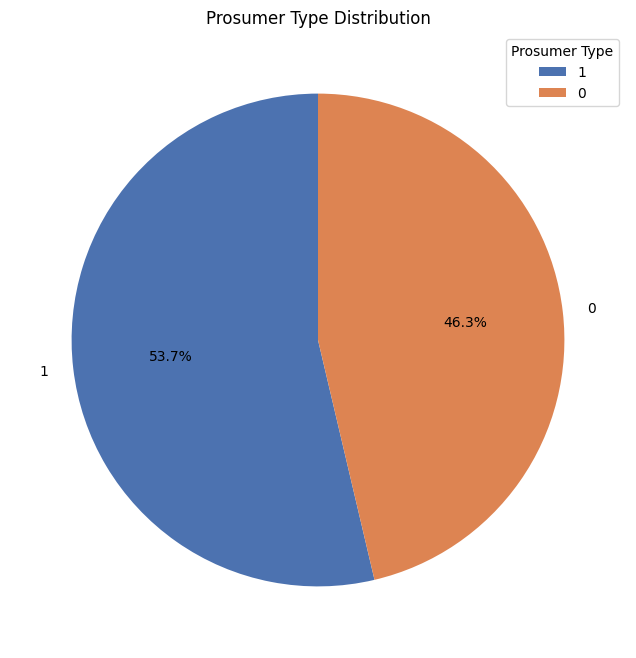

In [34]:
prosumer_type_counts = df_train_features['is_business'].value_counts()

plt.figure(figsize=(8, 8))
sns.set_palette("deep")
plt.pie(prosumer_type_counts, labels=prosumer_type_counts.index, autopct='%1.1f%%', startangle=90)
plt.legend(title='Prosumer Type', loc='upper right')
plt.title('Prosumer Type Distribution')
plt.show()

In [35]:
gas_prices_over_time = px.line(df_gas_prices, x='forecast_date', y=['lowest_price_per_mwh', 'highest_price_per_mwh'],
                               title='Gas Prices Over Time on Forecast Date ',
                               labels={'forecast_date': 'Forecast Date', 'value': 'Price (Euro/MWh)'})
gas_prices_over_time.update_layout(legend_title_text='Price Type')

In [36]:
gas_prices_over_time = px.line(df_gas_prices, x='origin_date', y=['lowest_price_per_mwh', 'highest_price_per_mwh'],
                               title='Gas Prices Over Time on Origin Date',
                               labels={'origin_date': 'Origin Date', 'value': 'Price (Euro/MWh)'})
gas_prices_over_time.update_layout(legend_title_text='Price Type')

In [37]:
gas_prices_over_time = px.line(df_gas_prices, x='data_block_id', y=['lowest_price_per_mwh', 'highest_price_per_mwh'],
                               title='Data Block Id based on Gas Prices Comparision',
                               labels={'data_block_id': 'Block ID', 'value': 'Price (Euro/MWh)'})
gas_prices_over_time.update_layout(legend_title_text='Price Type')

In [38]:
import polars as pl
import plotly.graph_objects as go

# Assuming df_electricity_prices is your DataFrame
# Check and convert forecast_date to string if it's not already
if df_electricity_prices['forecast_date'].dtype != pl.Utf8:
    df_electricity_prices = df_electricity_prices.with_columns(
        pl.col('forecast_date').cast(pl.Utf8)
    )

# Convert forecast_date to datetime
df_electricity_prices = df_electricity_prices.with_columns(
    pl.col('forecast_date').str.strptime(pl.Datetime, "%Y-%m-%d %H:%M:%S%.f")
)

# Extract date part from datetime
df_electricity_prices = df_electricity_prices.with_columns(
    pl.col('forecast_date').dt.date().alias('date')
)

# Group by date and calculate the mean of euros_per_mwh
df_electricity_prices_daily = df_electricity_prices.groupby('date').agg(
    pl.col('euros_per_mwh').mean().alias('euros_per_mwh')
).sort('date')

# Convert Polars DataFrame to Pandas DataFrame for Plotly
df_electricity_prices_pandas = df_electricity_prices.to_pandas()
df_electricity_prices_daily_pandas = df_electricity_prices_daily.to_pandas()

# Create traces
trace1 = go.Scatter(
    x=df_electricity_prices_pandas['forecast_date'],
    y=df_electricity_prices_pandas['euros_per_mwh'],
    mode='lines',
    name='Electricity Prices',
    line=dict(color='gray')
)

trace2 = go.Scatter(
    x=df_electricity_prices_daily_pandas['date'],
    y=df_electricity_prices_daily_pandas['euros_per_mwh'],
    mode='lines',
    name='Daily Average',
    line=dict(color='orange')
)

# Create the figure and add traces
fig = go.Figure()
fig.add_trace(trace1)
fig.add_trace(trace2)

# Update layout
fig.update_layout(
    title='Electricity Prices',
    xaxis_title='Date',
    yaxis_title='Euros per MWh',
    template='plotly_white'
)

# Show the figure
fig.show()


In [39]:
px.line(df_electricity_prices, x="origin_date", y="euros_per_mwh", title = "Electricity Price Distribution Based on Forecast Date")

In [40]:
px.line(df_electricity_prices, x="forecast_date", y="euros_per_mwh", title = "Electricity Price Distribution Based on Forecast Date")

In [41]:
temp_dewpoint_comparison = px.scatter(df_forecast_weather[:1000], x='forecast_datetime', y='temperature',
                                      color='dewpoint', title='Temperature vs. Dewpoint Over Time',
                                      labels={'forecast_datetime': 'Forecast Datetime', 'temperature': 'Temperature (°C)', 'dewpoint': 'Dewpoint (°C)'})
temp_dewpoint_comparison.show()

In [42]:
wind_speed_solar_radiation = px.scatter(df_forecast_weather[:1000], x='forecast_datetime', y='10_metre_u_wind_component',
                                        color='surface_solar_radiation_downwards',
                                        title='Wind Speed vs. Solar Radiation Over Time',
                                        labels={'forecast_datetime': 'Forecast Datetime', '10_metre_u_wind_component': 'Wind Speed (m/s)', 'surface_solar_radiation_downwards': 'Solar Radiation (W/m^2)'})
wind_speed_solar_radiation.show()

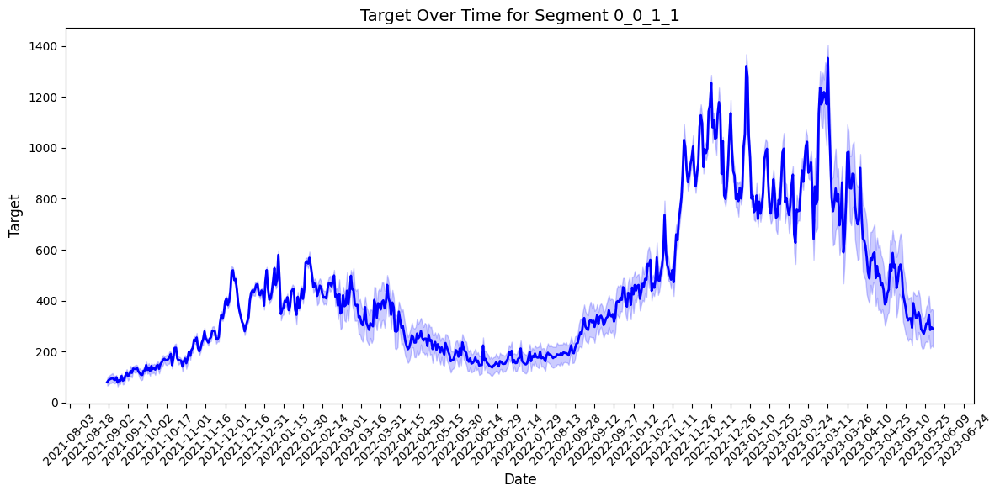

In [43]:
import matplotlib.dates as mdates

# Filter the dataset for the specific segment
consumption_0_0_1_1 = df_train_features[df_train_features.segment == '0_0_1_1']

plt.figure(figsize=(12, 6))
sns.lineplot(x='date', y='target', data=consumption_0_0_1_1, color='blue', linewidth=2)

plt.title('Target Over Time for Segment 0_0_1_1', fontsize=14)
plt.xlabel('Date', fontsize=12)
plt.ylabel('Target', fontsize=12)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d'))  # Format the date display
plt.gca().xaxis.set_major_locator(mdates.DayLocator(interval=15))  # Adjust the interval for better readability
plt.xticks(rotation=45)  # Rotate x-axis labels for clarity

# Show the plot
plt.tight_layout()
plt.show()

In [44]:
import plotly.express as px
from plotly.offline import init_notebook_mode
init_notebook_mode(connected=True)

c=['orangered', 'blue', 'gold', 'red', 'green', 'purple', 'orange', 'brown','gray','white','pink','yellow','silver','violet']
segment_list = df_train_features.segment.unique()[:len(c)]

i=0
# Filter the dataset for the specific segment
for seg in segment_list:
    consumption_segment = df_train_features[df_train_features.segment == seg]

    # Create a line plot using Plotly Express
    fig = px.line(consumption_segment, x='date', y='target', 
              title=f'Target Over Time for Segment {seg}',
              labels={'date': 'Date', 'target': 'Target'},
              template='plotly_dark',line_shape='linear')
    fig.update_traces(line=dict(color=c[i], width=1.5))

    # Customize the x-axis date format and tick interval
    fig.update_xaxes(type='date', tickformat='%Y-%m-%d', tickmode='linear', dtick=15)
    i+=1
    # Show the plot
    fig.show()

In [45]:
for i in range(6):
    
    prediction_unit_id = i

    df_plot = df_train_features[
    (df_train_features['prediction_unit_id'] == prediction_unit_id)
    ]

    fig = px.line(
      df_plot,
      x='date',
      y='target',
      color='is_consumption',
      title=f'Target for Prediction Unit: {prediction_unit_id}'
)

    fig.show()

# 4. Analyze base on Time series Algorithm

## FFT Analysis of Segments

To uncover potential high-frequency patterns within the dataset that may not be immediately apparent, a Fast Fourier Transform (FFT) analysis is conducted on the first ten unique segments of the dataset. This analysis aims to reveal hidden frequency-based characteristics and periodicities within these segments.

### Methodology

1. **Data Preparation**:
   - The first ten unique segments from `df_train_features` are selected for analysis.
   - A subset of the dataset, `example_df`, is created, containing only the data from these segments.

2. **FFT Computation**:
   - FFT is applied to the 'target' column of each segment. This transformation converts the time-domain data into the frequency domain, enabling the identification of dominant frequencies in the data.

3. **Frequency Analysis**:
   - The frequencies corresponding to each FFT value are calculated.
   - The magnitude of each FFT value is computed to quantify the strength of each frequency component.

4. **Normalization and Filtering**:
   - The magnitudes are normalized by dividing them by the maximum magnitude in each segment, ensuring comparability across segments.
   - Frequencies longer than the 'Semiannual' period are filtered out to focus on more relevant, shorter-term cycles.

5. **Visualization**:
   - A log-scaled plot is created to visualize the frequency spectra of each segment.
   - Each segment's spectrum is offset vertically for clarity, allowing distinct visualization of each segment's frequency characteristics.

### Conclusions
- In the first few segments analyzed, there is a notable presence of weak weekly periodicity.
- Across all segments, patterns with daily and hourly frequencies are prominently observed. These distinct patterns could be pivotal in identifying features that are correlated with or causally related to weather conditions or energy prices. Alternatively, they may well be artifacts caused by how the data are reported.

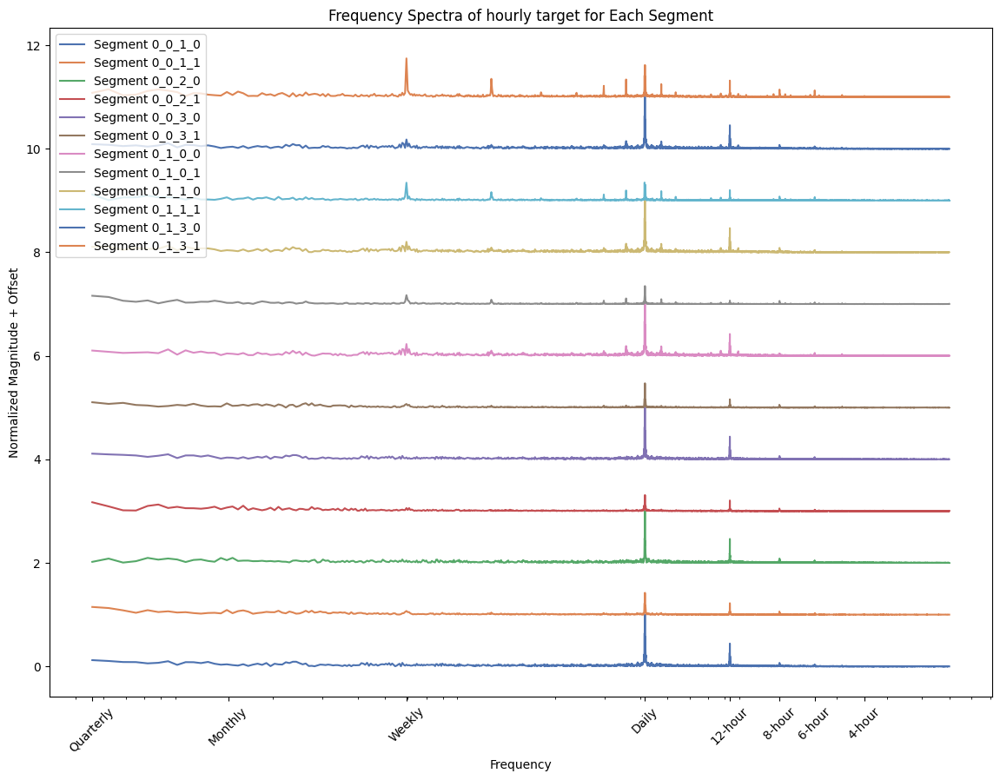

In [46]:
segment_list = df_train_features.segment.unique()[:12]
example_df = df_train_features[np.isin(df_train_features.segment,segment_list)]

# Periods now in hours
periods_in_hours = {
    'Quarterly': (365 / 4) * 24,
    'Monthly': 30 * 24,
    'Weekly': 7 * 24,
    'Daily': 24,
    '12-hour': 12,
    '8-hour': 8,
    '6-hour': 6,
    '4-hour': 4
}
frequencies_for_periods = {k: 1/v for k, v in periods_in_hours.items()}

# Plot adjustments remain mostly the same
plt.figure(figsize=(14, 10))
plt.xscale('log')

for i, segment in enumerate(example_df['segment'].unique()):
    segment_data = example_df[example_df['segment'] == segment]['target']
    fft_values = np.fft.fft(segment_data)
    frequencies = np.fft.fftfreq(len(fft_values), d=1)  # d=1 because data is hourly
    magnitudes = np.abs(fft_values)[frequencies > 0]
    normalized_magnitudes = magnitudes / np.max(magnitudes)
    positive_freqs = frequencies[frequencies > 0]

    # Adjust the filtering based on updated frequencies for periods
    valid_freqs = positive_freqs[positive_freqs > frequencies_for_periods['Quarterly']]
    valid_magnitudes = normalized_magnitudes[positive_freqs > frequencies_for_periods['Quarterly']]

    offset_magnitudes = valid_magnitudes + i  # Offset for clarity

    plt.plot(valid_freqs, offset_magnitudes, label=f'Segment {segment}')

plt.title('Frequency Spectra of hourly target for Each Segment')
plt.xlabel('Frequency')
plt.ylabel('Normalized Magnitude + Offset')
plt.xticks(list(frequencies_for_periods.values()), list(frequencies_for_periods.keys()),rotation=45)
plt.legend()
plt.show()

In [47]:
def fft_plots_enefit(name):
    # Initialize the figure for the spectrum using Plotly
    fig = go.Figure()

    # Convert the x-axis to a log scale
    fig.update_xaxes(type='log')

    # Plot the spectrum for the specified segment
    segment_data = example_df[example_df['segment'] == '0_0_1_1'][name]
    fft_values = np.fft.fft(segment_data)
    frequencies = np.fft.fftfreq(len(fft_values), d=1)
    magnitudes = np.abs(fft_values)[frequencies > 0]
    positive_freqs = frequencies[frequencies > 0]

    # Filter out frequencies corresponding to periods longer than 'Semiannual'
    valid_freqs = positive_freqs[positive_freqs > frequencies_for_periods['Quarterly']]
    valid_magnitudes = magnitudes[positive_freqs > frequencies_for_periods['Quarterly']]

    fig.add_trace(go.Scatter(x=valid_freqs, y=valid_magnitudes, mode='lines', name='0_0_1_1'))

    #  Customize the plot layout
    fig.update_layout(
    title=f'{name} frequency spectrum',
    xaxis_title='Frequency',
    yaxis_title='Magnitude',
    xaxis=dict(tickvals=list(frequencies_for_periods.values()), ticktext=list(frequencies_for_periods.keys())),
    showlegend=True,
    )

    # Show the plot
    fig.show()


In [48]:
plot_list=['temperature','direct_solar_radiation','hours_ahead','highest_price_per_mwh']
for i in plot_list:
    fft_plots_enefit(i)
    

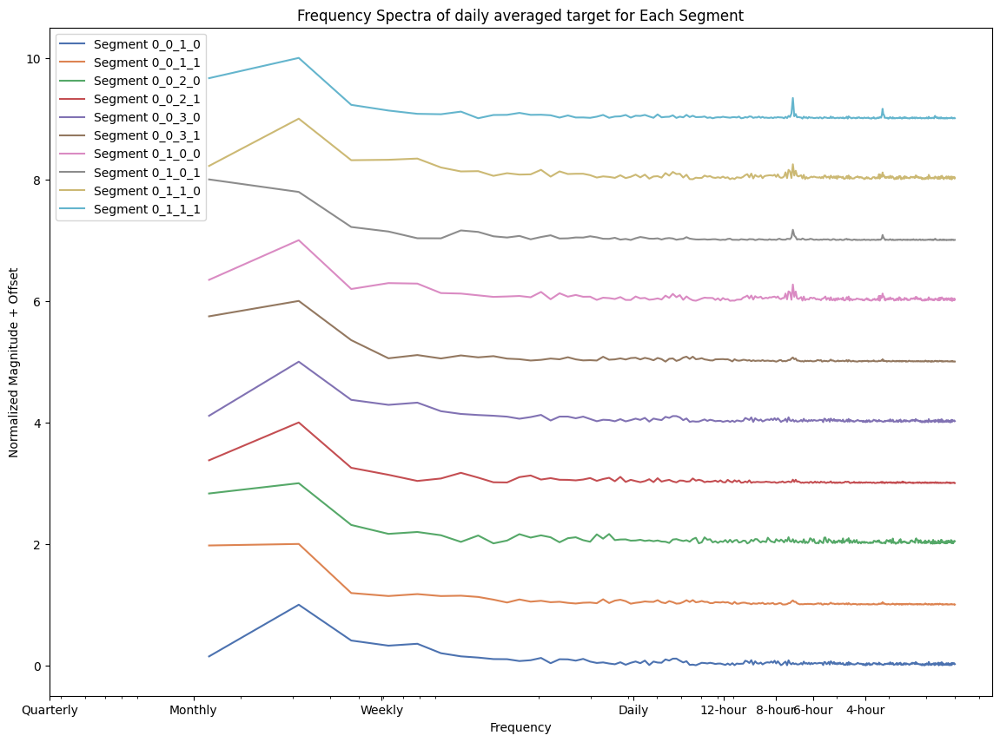

In [49]:
segment_list = df_train_features.segment.unique()[:10]
example_df = df_train_features[np.isin(df_train_features.segment,segment_list)]

# Initialize the figure for the spectra
plt.figure(figsize=(14, 10))

# Convert the x-axis to a log scale
plt.xscale('log')

# Plot the spectrum for each segment with offset
for i, segment in enumerate(example_df['segment'].unique()):
    segment_data = example_df[example_df['segment'] == segment].groupby('date')['target'].mean()
    fft_values = np.fft.fft(segment_data)
    frequencies = np.fft.fftfreq(len(fft_values), d=1)
    magnitudes = np.abs(fft_values)[frequencies > 0]
    normalized_magnitudes = magnitudes / np.max(magnitudes)
    positive_freqs = frequencies[frequencies > 0]

    # Offset each segment's spectrum for clarity
    offset_magnitudes = normalized_magnitudes + i

    plt.plot(positive_freqs, offset_magnitudes, label=f'Segment {segment}')

# Customize the plot
plt.title('Frequency Spectra of daily averaged target for Each Segment')
plt.xlabel('Frequency')
plt.ylabel('Normalized Magnitude + Offset')

# Set the x-axis ticks and labels to the calculated frequencies for the periods
plt.xticks(list(frequencies_for_periods.values()), list(frequencies_for_periods.keys()))

plt.legend()
plt.show()

## Singular-Spectrum Analysis (SSA)
Another tool for time-series data analysis is Singular Spectrum Analysis (SSA), which can be considered similar to Principal Component Analysis (PCA) but specifically tailored for time-series data.

This method involves constructing a trajectory matrix using lagged versions of the time series as its columns. By performing singular value decomposition (SVD) on this trajectory matrix, we can extract the principal components of the time series, which encapsulate key temporal characteristics such as trends and periodicities.

Unlike the Fourier transform (fft), SSA does not restrict components to be periodic; it can also capture irregular components, such as trends, which fft may not effectively represent. For more detailed explanation into this method, refer to this excellent [notebook](https://www.kaggle.com/code/jdarcy/introducing-ssa-for-time-series-decomposition/notebook#4.-A-Python-Class-for-SSA).

In [50]:
from numpy.linalg import svd, matrix_rank

class SSA:
    def __init__(self, series, window_size):
        self.series = np.array(series)
        self.window_size = window_size
        self.n = len(series)
        self.trajectory_matrix = self.create_trajectory_matrix()

    def create_trajectory_matrix(self):
        n_vectors = self.n - self.window_size + 1
        return np.column_stack([self.series[i:i+self.window_size] for i in range(n_vectors)])

    def decompose(self):
        U, sigma, Vt = svd(self.trajectory_matrix)
        self.rank = matrix_rank(self.trajectory_matrix)
        return U, sigma, Vt

    def reconstruct(self, U, sigma, Vt, components):
        rank = len(components)
        if rank > self.rank:
            raise ValueError("Number of components cannot be greater than the rank of the trajectory matrix")

        series_components = []
        for i in components:
            X_i = sigma[i] * np.outer(U[:,i], Vt[i,:])
            series_components.append(self.diagonal_averaging(X_i))
        
        return sum(series_components)

    def diagonal_averaging(self, X_i):
        n_rows, n_cols = X_i.shape
        diagonals = [X_i[::-1, :].diagonal(i) for i in range(-X_i.shape[0]+1, X_i.shape[1])]
        return np.array([np.mean(diagonal) for diagonal in diagonals])
    
    def calculate_w_correlation(self):
        n = self.window_size
        N = self.n
        K = N - n + 1
        w = np.array([min(i+1, n, N-i) for i in range(N)])
        w_corr_matrix = np.zeros((self.rank, self.rank))

        for i in range(self.rank):
            for j in range(self.rank):
                if i <= j:
                    F_i = self.reconstruct(U, sigma, Vt, [i])
                    F_j = self.reconstruct(U, sigma, Vt, [j])
                    w_corr_matrix[i, j] = np.sum(w * F_i * F_j) / np.sqrt(np.sum(w * F_i ** 2) * np.sum(w * F_j ** 2))
                    w_corr_matrix[j, i] = w_corr_matrix[i, j]
        
        return w_corr_matrix

    def plot_w_correlation(self, U, sigma, Vt):
        w_corr_matrix = self.calculate_w_correlation()
        plt.imshow(w_corr_matrix, cmap='hot', interpolation='nearest')
        plt.colorbar()
        plt.title('W-Correlation Matrix')
        plt.xlabel('Component')
        plt.ylabel('Component')
        plt.show()

### SSA Reconstruction
Considering the artifacts introduced by the hourly data, we will use daily aggregated data for our SSA analysis.

When we reconstruct the time series using the first five components, it becomes apparent that these components effectively capture the general trends of the time series. Furthermore, the analysis of the residuals reveals critical insights. Apart from the annual trend captured by the first few components, it is essential to consider high-frequency components that also contribute significantly to the dataset's characteristics, such as those wave-like fluctuations at the beginning of the time series.

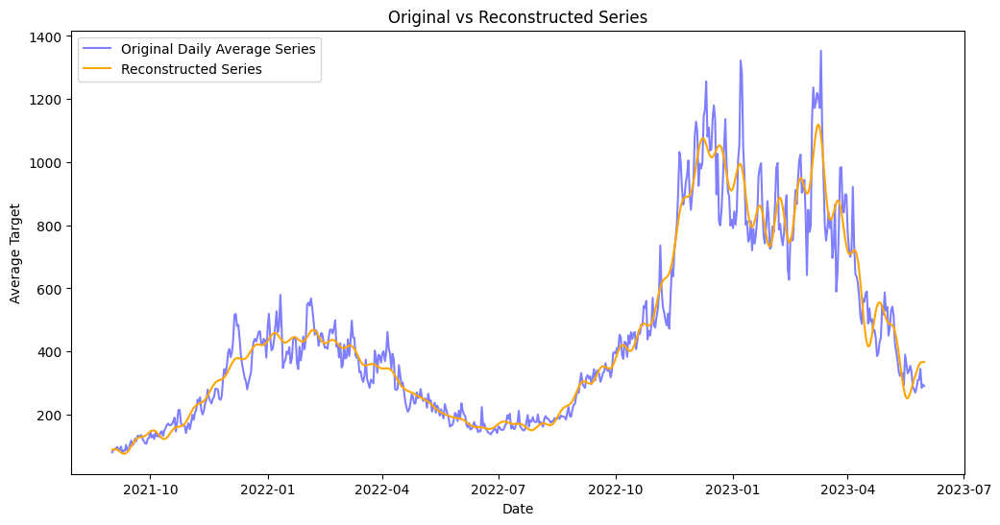

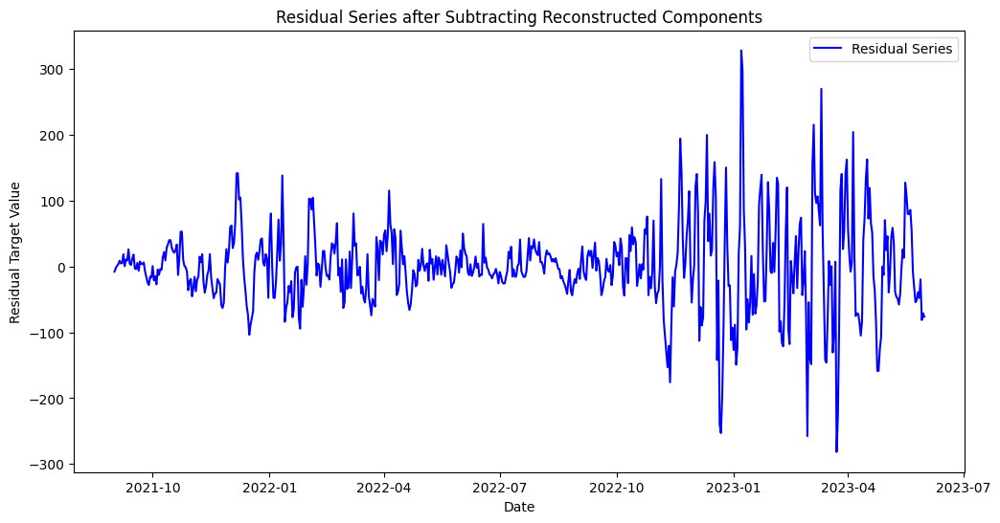

In [51]:
# Group by 'date' and calculate the mean of 'target' for each day
daily_avg = consumption_0_0_1_1.groupby('date')['target'].mean()

# Decompose the time series into 200 components, set by window_size
window_size = 200
ssa = SSA(daily_avg, window_size)
U, sigma, Vt = ssa.decompose()

# Reconstruct the series using the first 10 components
reconstructed_series = ssa.reconstruct(U, sigma, Vt, components=list(range(10)))

# Plot the original and reconstructed series
plt.figure(figsize=(12, 6))
plt.plot(daily_avg.index, daily_avg.values, alpha=0.5, label='Original Daily Average Series',color='blue')
plt.plot(daily_avg.index, reconstructed_series, label='Reconstructed Series',linewidth=1.5,color='orange')
plt.title('Original vs Reconstructed Series')
plt.xlabel('Date')
plt.ylabel('Average Target')
plt.legend()
plt.show()

# Subtract the reconstructed series from the original series
residual_series = daily_avg - reconstructed_series

# Plot the residual series
plt.figure(figsize=(12, 6))
plt.plot(daily_avg.index, residual_series, label='Residual Series',color='blue')
plt.title('Residual Series after Subtracting Reconstructed Components')
plt.xlabel('Date')
plt.ylabel('Residual Target Value')
plt.legend()
plt.show()


### SSA Components
The first ten mode shapes are presented below. The initial few components predominantly represent trends, while the higher components increasingly exhibit oscillatory behaviors, characterized by progressively higher frequencies. Notice that some modes are quite similar and that is totally normal in SSA. The resemblance between different modes can be visualized in the w-correlation matrix.

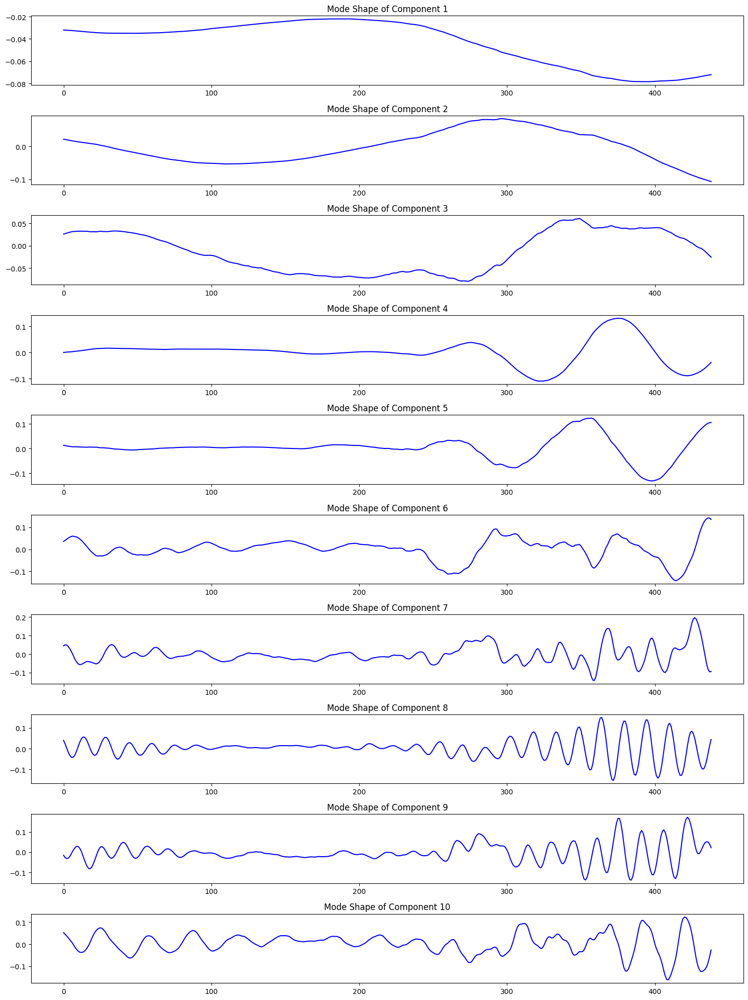

In [52]:
plt.figure(figsize=(15, 20))
for i in range(10):
    plt.subplot(10, 1, i+1)
    plt.plot(Vt[i, :], label=f'Component {i+1}',linewidth=1.5,color='blue')
    plt.title(f'Mode Shape of Component {i+1}')
plt.tight_layout()
plt.show()

### SSA Components
The first ten mode shapes are presented below. The initial few components predominantly represent trends, while the higher components increasingly exhibit oscillatory behaviors, characterized by progressively higher frequencies. Notice that some modes are quite similar and that is totally normal in SSA. The resemblance between different modes can be visualized in the w-correlation matrix.

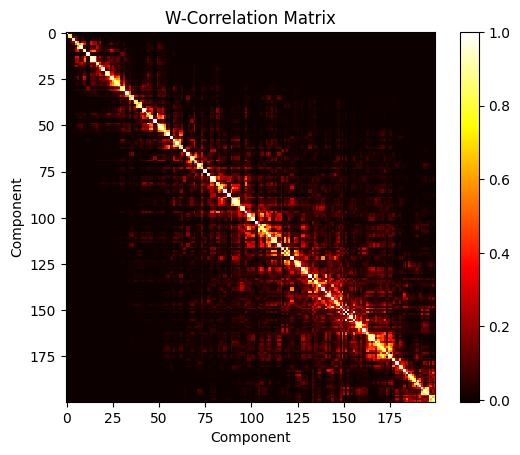

In [53]:
ssa.plot_w_correlation(U, sigma, Vt)